<a href="https://colab.research.google.com/github/rahiakela/genai-research-and-practice/blob/main/video-rag-works/01_gemini_video_understanding.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Setup

In [ ]:
!pip install -q -U google-generativeai
!pip install -q pytube

In [ ]:
!pip3 install pexelsPy

In [ ]:
!apt-get install -y ffmpeg

In [ ]:
# Get the API key from here: https://ai.google.dev/tutorials/setup
# Create a new secret called "GEMINI_API_KEY" via Add-ons -> Secrets in the top menu, and attach it to this notebook.
from google.colab import userdata
from IPython.display import display
from IPython.display import Markdown
from IPython.display import Video

import pathlib
import textwrap
import google.generativeai as genai

GOOGLE_API_KEY=userdata.get("GOOGLE_API_KEY")
genai.configure(api_key=GOOGLE_API_KEY)

def to_markdown(text):
  text = text.replace('•', '  *')
  return Markdown(textwrap.indent(text, '> ', predicate=lambda _: True))

In [ ]:
from pytube import YouTube

YouTube('https://www.youtube.com/shorts/I_UXIppRUWk').streams.get_highest_resolution().download()


'/content/How to fold POCKET SQUARE under 15 seconds!.mp4'

In [ ]:
import pandas as pd
import numpy as np
import cv2
import matplotlib.pyplot as plt
from glob import glob
import IPython.display as ipd
from tqdm import tqdm
import subprocess

import requests
import pexelsPy
import os

## Download Video

In [ ]:
PEXELS_API = userdata.get("PIXEL_API_KEY")
api = pexelsPy.API(PEXELS_API)

pageNumbers = 1
resultsPage = 5

api.search_videos('conference videos', page=pageNumbers, results_per_page=resultsPage)
videos = api.get_videos()


for data in videos:
    url_video = 'https://www.pexels.com/video/' + str(data.id) + '/download'
    r = requests.get(url_video)
    with open(data.url.split('/')[-2]+'.mp4', 'wb') as outfile:
        outfile.write(r.content)

In [ ]:
!mkdir sample_video
!mv *.mp4 sample_video

In [ ]:
base_path = "/content/sample_video/"
videos= os.listdir(base_path)
videos

['happy-people-working-together-7534401.mp4',
 'How to fold POCKET SQUARE under 15 seconds!.mp4',
 'a-woman-talking-in-a-business-conference-8717011.mp4',
 'man-writing-on-notebook-7534468.mp4',
 'woman-using-digital-tablet-7534734.mp4',
 'a-group-of-business-people-working-in-unity-6774847.mp4']

## Video to Image

<div class="anchor" id="top" style="
    margin-right: auto;
    margin-left: auto;
    padding: 10px;
   font-size : 120%;
    background-color: #17191e                                ;
    border-radius: 2px;
    color :  #FFFAEC  ;        
    border: 2px solid #FFF6D8;">
Checking the file name of the only file in the directory

In [ ]:
input_file = base_path + videos[0]
subprocess.run(['ffmpeg',
                '-i',
                input_file,
                '-qscale',
                '0',
                'mp4_converted_video.mp4'
                ]
              )

CompletedProcess(args=['ffmpeg', '-i', '/content/sample_video/happy-people-working-together-7534401.mp4', '-qscale', '0', 'mp4_converted_video.mp4'], returncode=0)

<div class="anchor" id="top" style="
    margin-right: auto;
    margin-left: auto;
    padding: 10px;
   font-size : 120%;
    background-color: #17191e                                ;
    border-radius: 2px;
    color :  #FFFAEC  ;        
    border: 2px solid #FFF6D8;">
    
- Playing the video

In [ ]:
ipd.Video('mp4_converted_video.mp4', embed=True)

<div class="anchor" id="top" style="
    margin-right: auto;
    margin-left: auto;
    padding: 10px;
   font-size : 120%;
    background-color: #17191e                                ;
    border-radius: 2px;
    color :  #FFFAEC  ;        
    border: 2px solid #FFF6D8;">

- Using [OpenCV](https://opencv.org/) in Python to create a VideoCapture object to read frames from a video file named 'mp4_converted_video.mp4'
    

In [ ]:
cap = cv2.VideoCapture('mp4_converted_video.mp4')

In [ ]:
# Total number of frames in video
cap.get(cv2.CAP_PROP_FRAME_COUNT)

442.0

In [ ]:
# Video height and width
height = cap.get(cv2.CAP_PROP_FRAME_HEIGHT)
width = cap.get(cv2.CAP_PROP_FRAME_WIDTH)
print(f'Height {height}, Width {width}')

Height 2732.0, Width 1440.0


In [ ]:
# Get frames per second
fps = cap.get(cv2.CAP_PROP_FPS)
print(f'FPS : {fps:0.2f}')

FPS : 25.00


In [ ]:
cap = cv2.VideoCapture('mp4_converted_video.mp4')
ret, img = cap.read()
print(f'Returned {ret} and img of shape {img.shape}')

Returned True and img of shape (2732, 1440, 3)


<div class="anchor" id="top" style="
    margin-right: auto;
    margin-left: auto;
    padding: 10px;
   font-size : 120%;
    background-color: #17191e                                ;
    border-radius: 2px;
    color :  #FFFAEC  ;        
    border: 2px solid #FFF6D8;">

- Plotting some of the frames to visualise the images
    
    

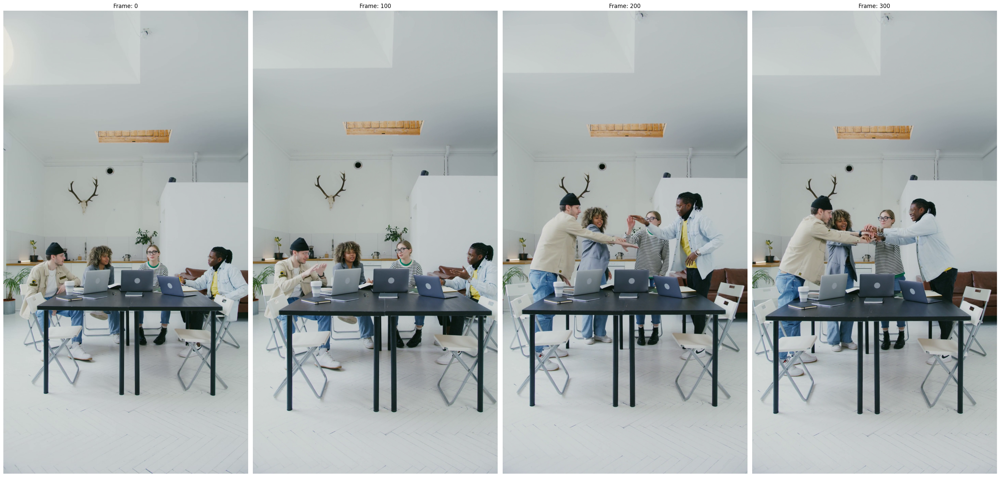

In [ ]:
fig, axs = plt.subplots(1, 4, figsize=(30, 20))
axs = axs.flatten()

cap = cv2.VideoCapture("mp4_converted_video.mp4")
n_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

img_idx = 0
for frame in range(n_frames):
    ret, img = cap.read()
    if frame == 400:
        break
    if frame % 100 == 0:
        axs[img_idx].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        axs[img_idx].set_title(f'Frame: {frame}')
        axs[img_idx].axis('off')
        img_idx += 1

plt.tight_layout()
plt.show()
cap.release()

In [ ]:
from skimage.metrics import structural_similarity as ssim
import os

# Opening the video file
cap = cv2.VideoCapture("mp4_converted_video.mp4")
n_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

# Creating a directory to save the selected frames
output_directory = 'selected_frames'
os.makedirs(output_directory, exist_ok=True)

selected_frames = []
previous_frame = None
threshold = 0.80  # threshold

for frame_idx in tqdm(range(n_frames), desc="Processing Frames"):
    ret, img = cap.read()

    if not ret:
        break

    # Splitting the frame into RGB channels
    b, g, r = cv2.split(img)

    if previous_frame is not None:
        # Structural Similarity Index (SSI) for each channel
        ssim_b, _ = ssim(previous_frame[0], b, full=True)
        ssim_g, _ = ssim(previous_frame[1], g, full=True)
        ssim_r, _ = ssim(previous_frame[2], r, full=True)

        # Combining the SSIM scores from each channel
        similarity_index = (ssim_b + ssim_g + ssim_r) / 3

        # If frames are distinct enough, then only adding the current frame to the selected frames
        print(similarity_index)
        if similarity_index < threshold:
            selected_frames.append(img)

            # Saving the selected frame to the output directory
            frame_filename = os.path.join(output_directory, f"frame_{frame_idx:04d}.png")
            cv2.imwrite(frame_filename, img)

    previous_frame = cv2.split(img)

# Releasing the video capture object to free the space captured
cap.release()


Processing Frames:   0%|          | 2/442 [00:02<09:29,  1.30s/it]

0.9792574717786908


Processing Frames:   1%|          | 3/442 [00:04<12:55,  1.77s/it]

0.98221608701462


Processing Frames:   1%|          | 4/442 [00:06<13:07,  1.80s/it]

0.9817200864651802


Processing Frames:   1%|          | 5/442 [00:07<12:10,  1.67s/it]

0.9802352694701884


Processing Frames:   1%|▏         | 6/442 [00:09<11:48,  1.63s/it]

0.977775190961366


Processing Frames:   2%|▏         | 7/442 [00:11<11:42,  1.61s/it]

0.9804444979586279


Processing Frames:   2%|▏         | 8/442 [00:12<11:56,  1.65s/it]

0.9805851367978122


Processing Frames:   2%|▏         | 9/442 [00:14<11:28,  1.59s/it]

0.9797293527649363


Processing Frames:   2%|▏         | 10/442 [00:15<11:10,  1.55s/it]

0.9760244814511766


Processing Frames:   2%|▏         | 11/442 [00:17<10:51,  1.51s/it]

0.976347588941182


Processing Frames:   3%|▎         | 12/442 [00:18<10:46,  1.50s/it]

0.9784981610571192


Processing Frames:   3%|▎         | 13/442 [00:19<10:32,  1.47s/it]

0.9763203827385407


Processing Frames:   3%|▎         | 14/442 [00:21<10:30,  1.47s/it]

0.9730325672594616


Processing Frames:   3%|▎         | 15/442 [00:22<10:21,  1.46s/it]

0.9768508355736398


Processing Frames:   4%|▎         | 16/442 [00:24<10:42,  1.51s/it]

0.9777455799141831


Processing Frames:   4%|▍         | 17/442 [00:26<10:57,  1.55s/it]

0.9773327014694305


Processing Frames:   4%|▍         | 18/442 [00:27<10:47,  1.53s/it]

0.9755861049851289


Processing Frames:   4%|▍         | 19/442 [00:29<10:32,  1.50s/it]

0.9766752022675688


Processing Frames:   5%|▍         | 20/442 [00:30<10:27,  1.49s/it]

0.9768748635226597


Processing Frames:   5%|▍         | 21/442 [00:31<10:16,  1.46s/it]

0.9768920417400695


Processing Frames:   5%|▍         | 22/442 [00:33<10:18,  1.47s/it]

0.9736688305551712


Processing Frames:   5%|▌         | 23/442 [00:34<10:09,  1.45s/it]

0.9745862071776608


Processing Frames:   5%|▌         | 24/442 [00:36<10:15,  1.47s/it]

0.9757014218772581


Processing Frames:   6%|▌         | 25/442 [00:37<10:36,  1.53s/it]

0.9763966124096496


Processing Frames:   6%|▌         | 26/442 [00:39<10:47,  1.56s/it]

0.9757081390722416


Processing Frames:   6%|▌         | 27/442 [00:41<10:36,  1.53s/it]

0.977311818081713


Processing Frames:   6%|▋         | 28/442 [00:42<10:27,  1.52s/it]

0.9783283804029246


Processing Frames:   7%|▋         | 29/442 [00:44<10:19,  1.50s/it]

0.9800309250604385


Processing Frames:   7%|▋         | 30/442 [00:45<10:13,  1.49s/it]

0.9790645253194397


Processing Frames:   7%|▋         | 31/442 [00:46<10:10,  1.48s/it]

0.9806013237123804


Processing Frames:   7%|▋         | 32/442 [00:48<10:03,  1.47s/it]

0.9807365534910998


Processing Frames:   7%|▋         | 33/442 [00:50<10:16,  1.51s/it]

0.98165512603267


Processing Frames:   8%|▊         | 34/442 [00:51<10:39,  1.57s/it]

0.9796788100970244


Processing Frames:   8%|▊         | 35/442 [00:53<10:33,  1.56s/it]

0.9780935415959674


Processing Frames:   8%|▊         | 36/442 [00:54<10:31,  1.55s/it]

0.9773090730649377


Processing Frames:   8%|▊         | 37/442 [00:56<10:23,  1.54s/it]

0.9776740396484996


Processing Frames:   9%|▊         | 38/442 [00:57<10:23,  1.54s/it]

0.9749824963615801


Processing Frames:   9%|▉         | 39/442 [00:59<10:19,  1.54s/it]

0.9776822330294695


Processing Frames:   9%|▉         | 40/442 [01:00<10:08,  1.51s/it]

0.9771033671141928


Processing Frames:   9%|▉         | 41/442 [01:02<10:25,  1.56s/it]

0.9748020063897155


Processing Frames:  10%|▉         | 42/442 [01:04<10:55,  1.64s/it]

0.9713711704251023


Processing Frames:  10%|▉         | 43/442 [01:06<11:24,  1.71s/it]

0.971315251487772


Processing Frames:  10%|▉         | 44/442 [01:07<11:10,  1.68s/it]

0.9739049567660434


Processing Frames:  10%|█         | 45/442 [01:09<10:35,  1.60s/it]

0.9748273180529586


Processing Frames:  10%|█         | 46/442 [01:10<10:19,  1.57s/it]

0.9736263806136121


Processing Frames:  11%|█         | 47/442 [01:12<10:00,  1.52s/it]

0.9727349810166496


Processing Frames:  11%|█         | 48/442 [01:13<09:55,  1.51s/it]

0.9720266899211305


Processing Frames:  11%|█         | 49/442 [01:15<09:45,  1.49s/it]

0.9722411956854252


Processing Frames:  11%|█▏        | 50/442 [01:16<09:43,  1.49s/it]

0.9709836193396203


Processing Frames:  12%|█▏        | 51/442 [01:18<09:56,  1.53s/it]

0.9726606638474161


Processing Frames:  12%|█▏        | 52/442 [01:19<10:13,  1.57s/it]

0.9703293375936268


Processing Frames:  12%|█▏        | 53/442 [01:21<10:03,  1.55s/it]

0.9625572362449232


Processing Frames:  12%|█▏        | 54/442 [01:22<09:53,  1.53s/it]

0.95927483360177


Processing Frames:  12%|█▏        | 55/442 [01:24<09:38,  1.49s/it]

0.9611988174559132


Processing Frames:  13%|█▎        | 56/442 [01:25<09:37,  1.50s/it]

0.9660528770898277


Processing Frames:  13%|█▎        | 57/442 [01:27<09:30,  1.48s/it]

0.9709061898402318


Processing Frames:  13%|█▎        | 58/442 [01:28<09:26,  1.48s/it]

0.9683443511247565


Processing Frames:  13%|█▎        | 59/442 [01:30<09:17,  1.46s/it]

0.9668402314969541


Processing Frames:  14%|█▎        | 60/442 [01:31<09:41,  1.52s/it]

0.9680560810157809


Processing Frames:  14%|█▍        | 61/442 [01:33<09:57,  1.57s/it]

0.9704207914331467


Processing Frames:  14%|█▍        | 62/442 [01:34<09:44,  1.54s/it]

0.9719368065905877


Processing Frames:  14%|█▍        | 63/442 [01:36<09:27,  1.50s/it]

0.9727814303884289


Processing Frames:  14%|█▍        | 64/442 [01:37<09:23,  1.49s/it]

0.9683187855540084


Processing Frames:  15%|█▍        | 65/442 [01:39<09:13,  1.47s/it]

0.9626253034069471


Processing Frames:  15%|█▍        | 66/442 [01:40<09:43,  1.55s/it]

0.9624436799476523


Processing Frames:  15%|█▌        | 67/442 [01:42<09:24,  1.51s/it]

0.9664115524325259


Processing Frames:  15%|█▌        | 68/442 [01:43<09:27,  1.52s/it]

0.9696915156517222


Processing Frames:  16%|█▌        | 69/442 [01:45<09:37,  1.55s/it]

0.973621736141057


Processing Frames:  16%|█▌        | 70/442 [01:47<09:43,  1.57s/it]

0.9748233532362772


Processing Frames:  16%|█▌        | 71/442 [01:48<09:25,  1.52s/it]

0.9769828771100005


Processing Frames:  16%|█▋        | 72/442 [01:49<09:16,  1.50s/it]

0.9766755482652713


Processing Frames:  17%|█▋        | 73/442 [01:51<09:03,  1.47s/it]

0.9756397494988521


Processing Frames:  17%|█▋        | 74/442 [01:52<08:59,  1.47s/it]

0.9730325021675204


Processing Frames:  17%|█▋        | 75/442 [01:54<08:50,  1.45s/it]

0.9699526506625896


Processing Frames:  17%|█▋        | 76/442 [01:55<08:53,  1.46s/it]

0.9611998554458743


Processing Frames:  17%|█▋        | 77/442 [01:57<08:55,  1.47s/it]

0.9509134252508927


Processing Frames:  18%|█▊        | 78/442 [01:59<11:15,  1.86s/it]

0.9557143783450331


Processing Frames:  18%|█▊        | 79/442 [02:01<10:26,  1.73s/it]

0.9605644818540808


Processing Frames:  18%|█▊        | 80/442 [02:02<09:57,  1.65s/it]

0.969206362244126


Processing Frames:  18%|█▊        | 81/442 [02:04<09:41,  1.61s/it]

0.9758633615940152


Processing Frames:  19%|█▊        | 82/442 [02:05<09:19,  1.55s/it]

0.9710301715683451


Processing Frames:  19%|█▉        | 83/442 [02:07<09:00,  1.51s/it]

0.971877929713811


Processing Frames:  19%|█▉        | 84/442 [02:08<08:47,  1.47s/it]

0.976517023953011


Processing Frames:  19%|█▉        | 85/442 [02:10<08:42,  1.46s/it]

0.9787785035513575


Processing Frames:  19%|█▉        | 86/442 [02:11<08:57,  1.51s/it]

0.9788967123485928


Processing Frames:  20%|█▉        | 87/442 [02:13<09:20,  1.58s/it]

0.9767967442747935


Processing Frames:  20%|█▉        | 88/442 [02:14<09:09,  1.55s/it]

0.9750891703791652


Processing Frames:  20%|██        | 89/442 [02:16<08:58,  1.53s/it]

0.978311947436282


Processing Frames:  20%|██        | 90/442 [02:17<08:50,  1.51s/it]

0.9771326302061696


Processing Frames:  21%|██        | 91/442 [02:19<08:44,  1.49s/it]

0.977545735646732


Processing Frames:  21%|██        | 92/442 [02:20<08:39,  1.48s/it]

0.9803843105405147


Processing Frames:  21%|██        | 93/442 [02:22<08:30,  1.46s/it]

0.9843251136670325


Processing Frames:  21%|██▏       | 94/442 [02:23<08:40,  1.50s/it]

0.981407228864153


Processing Frames:  21%|██▏       | 95/442 [02:25<08:54,  1.54s/it]

0.9793826033285309


Processing Frames:  22%|██▏       | 96/442 [02:26<08:55,  1.55s/it]

0.9803974985341792


Processing Frames:  22%|██▏       | 97/442 [02:28<08:40,  1.51s/it]

0.9804189659754217


Processing Frames:  22%|██▏       | 98/442 [02:29<08:37,  1.50s/it]

0.9824793313312868


Processing Frames:  22%|██▏       | 99/442 [02:31<08:26,  1.48s/it]

0.9738099997703756


Processing Frames:  23%|██▎       | 100/442 [02:32<08:23,  1.47s/it]

0.9595866246187508


Processing Frames:  23%|██▎       | 101/442 [02:34<08:25,  1.48s/it]

0.9599552090959955


Processing Frames:  23%|██▎       | 102/442 [02:35<08:22,  1.48s/it]

0.9684803994693065


Processing Frames:  23%|██▎       | 103/442 [02:37<08:36,  1.52s/it]

0.9770341107519621


Processing Frames:  24%|██▎       | 104/442 [02:39<08:54,  1.58s/it]

0.980306920767093


Processing Frames:  24%|██▍       | 105/442 [02:40<08:43,  1.55s/it]

0.9802910945676594


Processing Frames:  24%|██▍       | 106/442 [02:42<08:36,  1.54s/it]

0.9798926402550143


Processing Frames:  24%|██▍       | 107/442 [02:43<08:24,  1.51s/it]

0.9818863260766908


Processing Frames:  24%|██▍       | 108/442 [02:44<08:25,  1.51s/it]

0.9786094845593268


Processing Frames:  25%|██▍       | 109/442 [02:46<08:19,  1.50s/it]

0.9774713736553644


Processing Frames:  25%|██▍       | 110/442 [02:47<08:15,  1.49s/it]

0.9773042200407366


Processing Frames:  25%|██▌       | 111/442 [02:49<08:08,  1.48s/it]

0.9783707432625667


Processing Frames:  25%|██▌       | 112/442 [02:51<08:30,  1.55s/it]

0.9740323597286947


Processing Frames:  26%|██▌       | 113/442 [02:52<08:31,  1.56s/it]

0.9710281116326365


Processing Frames:  26%|██▌       | 114/442 [02:54<08:21,  1.53s/it]

0.9751093592791227


Processing Frames:  26%|██▌       | 115/442 [02:55<08:09,  1.50s/it]

0.976956584740326


Processing Frames:  26%|██▌       | 116/442 [02:57<08:05,  1.49s/it]

0.9705639700435893


Processing Frames:  26%|██▋       | 117/442 [02:58<07:55,  1.46s/it]

0.9664604092803394


Processing Frames:  27%|██▋       | 118/442 [02:59<07:55,  1.47s/it]

0.9737281395168357


Processing Frames:  27%|██▋       | 119/442 [03:01<07:50,  1.46s/it]

0.9756332180941598


Processing Frames:  27%|██▋       | 120/442 [03:02<07:57,  1.48s/it]

0.964969006345277


Processing Frames:  27%|██▋       | 121/442 [03:04<08:14,  1.54s/it]

0.9651720349536039


Processing Frames:  28%|██▊       | 122/442 [03:06<08:15,  1.55s/it]

0.9749784667058812


Processing Frames:  28%|██▊       | 123/442 [03:07<08:07,  1.53s/it]

0.9740741488301098


Processing Frames:  28%|██▊       | 124/442 [03:09<07:56,  1.50s/it]

0.9588699533101828


Processing Frames:  28%|██▊       | 125/442 [03:10<07:52,  1.49s/it]

0.9620031128686873


Processing Frames:  29%|██▊       | 126/442 [03:11<07:42,  1.46s/it]

0.974385811667721


Processing Frames:  29%|██▊       | 127/442 [03:13<07:42,  1.47s/it]

0.9773154314936175


Processing Frames:  29%|██▉       | 128/442 [03:14<07:40,  1.47s/it]

0.9580528742294154


Processing Frames:  29%|██▉       | 129/442 [03:16<07:53,  1.51s/it]

0.9555056893530334


Processing Frames:  29%|██▉       | 130/442 [03:18<08:07,  1.56s/it]

0.9661966778867631


Processing Frames:  30%|██▉       | 131/442 [03:19<08:02,  1.55s/it]

0.9752003478682157


Processing Frames:  30%|██▉       | 132/442 [03:21<07:57,  1.54s/it]

0.9649289780008306


Processing Frames:  30%|███       | 133/442 [03:22<07:46,  1.51s/it]

0.9572328153060701


Processing Frames:  30%|███       | 134/442 [03:24<07:43,  1.50s/it]

0.9574824008519155


Processing Frames:  31%|███       | 135/442 [03:25<07:34,  1.48s/it]

0.9531333444130342


Processing Frames:  31%|███       | 136/442 [03:26<07:31,  1.47s/it]

0.9496330381835402


Processing Frames:  31%|███       | 137/442 [03:28<07:24,  1.46s/it]

0.9615491843334812


Processing Frames:  31%|███       | 138/442 [03:30<07:43,  1.53s/it]

0.9678394198755664


Processing Frames:  31%|███▏      | 139/442 [03:31<07:50,  1.55s/it]

0.9659951619630288


Processing Frames:  32%|███▏      | 140/442 [03:33<07:41,  1.53s/it]

0.9571944627996819


Processing Frames:  32%|███▏      | 141/442 [03:34<07:33,  1.51s/it]

0.9588867901945409


Processing Frames:  32%|███▏      | 142/442 [03:36<07:29,  1.50s/it]

0.9589371733301514


Processing Frames:  32%|███▏      | 143/442 [03:37<07:20,  1.47s/it]

0.9561502804099624


Processing Frames:  33%|███▎      | 144/442 [03:39<07:19,  1.47s/it]

0.953461298570188


Processing Frames:  33%|███▎      | 145/442 [03:40<07:26,  1.50s/it]

0.94911011889674


Processing Frames:  33%|███▎      | 146/442 [03:42<07:33,  1.53s/it]

0.9466220675765135


Processing Frames:  33%|███▎      | 147/442 [03:43<07:43,  1.57s/it]

0.9468635424548774


Processing Frames:  33%|███▎      | 148/442 [03:45<07:33,  1.54s/it]

0.9484151325601574


Processing Frames:  34%|███▎      | 149/442 [03:46<07:18,  1.50s/it]

0.9453751366814576


Processing Frames:  34%|███▍      | 150/442 [03:48<07:06,  1.46s/it]

0.9374799178927379


Processing Frames:  34%|███▍      | 151/442 [03:49<06:56,  1.43s/it]

0.9321317126250025


Processing Frames:  34%|███▍      | 152/442 [03:50<06:49,  1.41s/it]

0.9408990432667034


Processing Frames:  35%|███▍      | 153/442 [03:52<06:57,  1.45s/it]

0.9483986948400425


Processing Frames:  35%|███▍      | 154/442 [03:53<07:03,  1.47s/it]

0.9485283220203687


Processing Frames:  35%|███▌      | 155/442 [03:55<07:15,  1.52s/it]

0.9327610510004755


Processing Frames:  35%|███▌      | 156/442 [03:57<07:32,  1.58s/it]

0.9322293386068882


Processing Frames:  36%|███▌      | 157/442 [03:58<07:24,  1.56s/it]

0.9437266550866359


Processing Frames:  36%|███▌      | 158/442 [04:00<07:13,  1.53s/it]

0.9435889751973323


Processing Frames:  36%|███▌      | 159/442 [04:01<07:01,  1.49s/it]

0.9395232617328683


Processing Frames:  36%|███▌      | 160/442 [04:03<06:58,  1.48s/it]

0.9443975336209385


Processing Frames:  36%|███▋      | 161/442 [04:04<06:51,  1.47s/it]

0.9524768145490373


Processing Frames:  37%|███▋      | 162/442 [04:05<06:50,  1.47s/it]

0.9511149521368795


Processing Frames:  37%|███▋      | 163/442 [04:07<06:44,  1.45s/it]

0.9455415645358066


Processing Frames:  37%|███▋      | 164/442 [04:09<06:59,  1.51s/it]

0.9510950559233239


Processing Frames:  37%|███▋      | 165/442 [04:10<07:11,  1.56s/it]

0.9561126169033901


Processing Frames:  38%|███▊      | 166/442 [04:12<07:04,  1.54s/it]

0.9539201416076345


Processing Frames:  38%|███▊      | 167/442 [04:13<07:00,  1.53s/it]

0.94643393503503


Processing Frames:  38%|███▊      | 168/442 [04:15<07:15,  1.59s/it]

0.9480661759379011


Processing Frames:  38%|███▊      | 169/442 [04:16<07:12,  1.58s/it]

0.9523617237294687


Processing Frames:  38%|███▊      | 170/442 [04:18<07:03,  1.56s/it]

0.9559650709079408


Processing Frames:  39%|███▊      | 171/442 [04:19<06:49,  1.51s/it]

0.9573540302028637


Processing Frames:  39%|███▉      | 172/442 [04:21<06:52,  1.53s/it]

0.952608669568018


Processing Frames:  39%|███▉      | 173/442 [04:23<07:03,  1.57s/it]

0.9494523886783789


Processing Frames:  39%|███▉      | 174/442 [04:24<06:55,  1.55s/it]

0.9492491404649143


Processing Frames:  40%|███▉      | 175/442 [04:26<06:46,  1.52s/it]

0.9529787493603347


Processing Frames:  40%|███▉      | 176/442 [04:27<06:37,  1.49s/it]

0.9588016832664362


Processing Frames:  40%|████      | 177/442 [04:29<06:37,  1.50s/it]

0.9596586801433689


Processing Frames:  40%|████      | 178/442 [04:30<06:37,  1.51s/it]

0.957318649210972


Processing Frames:  40%|████      | 179/442 [04:31<06:32,  1.49s/it]

0.9580290818375584


Processing Frames:  41%|████      | 180/442 [04:33<06:24,  1.47s/it]

0.9559348731778874


Processing Frames:  41%|████      | 181/442 [04:35<06:35,  1.52s/it]

0.9551880090449023


Processing Frames:  41%|████      | 182/442 [04:36<06:45,  1.56s/it]

0.9535405554676989


Processing Frames:  41%|████▏     | 183/442 [04:38<06:43,  1.56s/it]

0.9541813397802624


Processing Frames:  42%|████▏     | 184/442 [04:39<06:39,  1.55s/it]

0.9541807218790958


Processing Frames:  42%|████▏     | 185/442 [04:41<06:32,  1.53s/it]

0.9523078690903954


Processing Frames:  42%|████▏     | 186/442 [04:42<06:31,  1.53s/it]

0.9538315477206109


Processing Frames:  42%|████▏     | 187/442 [04:44<06:26,  1.51s/it]

0.9569791977720908


Processing Frames:  43%|████▎     | 188/442 [04:45<06:21,  1.50s/it]

0.9580489968864904


Processing Frames:  43%|████▎     | 189/442 [04:47<06:19,  1.50s/it]

0.957244242280923


Processing Frames:  43%|████▎     | 190/442 [04:48<06:38,  1.58s/it]

0.9559951326387841


Processing Frames:  43%|████▎     | 191/442 [04:50<06:35,  1.58s/it]

0.9559379179091767


Processing Frames:  43%|████▎     | 192/442 [04:52<06:26,  1.55s/it]

0.9557227700272249


Processing Frames:  44%|████▎     | 193/442 [04:53<06:16,  1.51s/it]

0.9576706155744695


Processing Frames:  44%|████▍     | 194/442 [04:54<06:13,  1.50s/it]

0.9583761240302874


Processing Frames:  44%|████▍     | 195/442 [04:56<06:06,  1.49s/it]

0.9587365755114995


Processing Frames:  44%|████▍     | 196/442 [04:57<06:04,  1.48s/it]

0.9577714812364503


Processing Frames:  45%|████▍     | 197/442 [04:59<05:59,  1.47s/it]

0.9588847428928379


Processing Frames:  45%|████▍     | 198/442 [05:00<06:05,  1.50s/it]

0.9606788768234469


Processing Frames:  45%|████▌     | 199/442 [05:02<06:15,  1.55s/it]

0.9630016502061088


Processing Frames:  45%|████▌     | 200/442 [05:04<06:09,  1.53s/it]

0.9625901270811154


Processing Frames:  45%|████▌     | 201/442 [05:05<06:00,  1.50s/it]

0.9594404114892572


Processing Frames:  46%|████▌     | 202/442 [05:06<05:57,  1.49s/it]

0.9570981927351102


Processing Frames:  46%|████▌     | 203/442 [05:08<05:51,  1.47s/it]

0.9580450668769567


Processing Frames:  46%|████▌     | 204/442 [05:09<05:50,  1.47s/it]

0.9582849944285674


Processing Frames:  46%|████▋     | 205/442 [05:11<05:46,  1.46s/it]

0.9636627137890077


Processing Frames:  47%|████▋     | 206/442 [05:12<05:49,  1.48s/it]

0.9695265589643732


Processing Frames:  47%|████▋     | 207/442 [05:14<06:01,  1.54s/it]

0.9753090036469438


Processing Frames:  47%|████▋     | 208/442 [05:16<06:03,  1.56s/it]

0.9770321168696947


Processing Frames:  47%|████▋     | 209/442 [05:17<05:54,  1.52s/it]

0.9770158380526137


Processing Frames:  48%|████▊     | 210/442 [05:19<05:52,  1.52s/it]

0.976763527363465


Processing Frames:  48%|████▊     | 211/442 [05:20<05:45,  1.50s/it]

0.976937355052299


Processing Frames:  48%|████▊     | 212/442 [05:21<05:42,  1.49s/it]

0.975938800372581


Processing Frames:  48%|████▊     | 213/442 [05:23<05:38,  1.48s/it]

0.9753752751996525


Processing Frames:  48%|████▊     | 214/442 [05:24<05:35,  1.47s/it]

0.9756780869547245


Processing Frames:  49%|████▊     | 215/442 [05:26<05:38,  1.49s/it]

0.9759771369189197


Processing Frames:  49%|████▉     | 216/442 [05:28<05:55,  1.57s/it]

0.9770927444442652


Processing Frames:  49%|████▉     | 217/442 [05:29<05:51,  1.56s/it]

0.9746918831801895


Processing Frames:  49%|████▉     | 218/442 [05:31<05:47,  1.55s/it]

0.974007139270031


Processing Frames:  50%|████▉     | 219/442 [05:32<05:37,  1.52s/it]

0.9749632177828147


Processing Frames:  50%|████▉     | 220/442 [05:34<05:34,  1.51s/it]

0.971808108599313


Processing Frames:  50%|█████     | 221/442 [05:35<05:29,  1.49s/it]

0.966428822956531


Processing Frames:  50%|█████     | 222/442 [05:37<05:30,  1.50s/it]

0.967800682298042


Processing Frames:  50%|█████     | 223/442 [05:38<05:27,  1.49s/it]

0.9701581727166205


Processing Frames:  51%|█████     | 224/442 [05:40<05:40,  1.56s/it]

0.9636959516443676


Processing Frames:  51%|█████     | 225/442 [05:41<05:45,  1.59s/it]

0.9613402805373061


Processing Frames:  51%|█████     | 226/442 [05:43<05:36,  1.56s/it]

0.96081854260584


Processing Frames:  51%|█████▏    | 227/442 [05:44<05:27,  1.52s/it]

0.951869377946966


Processing Frames:  52%|█████▏    | 228/442 [05:46<05:24,  1.51s/it]

0.9571103235983637


Processing Frames:  52%|█████▏    | 229/442 [05:47<05:25,  1.53s/it]

0.9694122311513095


Processing Frames:  52%|█████▏    | 230/442 [05:49<05:20,  1.51s/it]

0.9771694016522012


Processing Frames:  52%|█████▏    | 231/442 [05:50<05:12,  1.48s/it]

0.9773530631449066


Processing Frames:  52%|█████▏    | 232/442 [05:52<05:16,  1.51s/it]

0.9804638960233549


Processing Frames:  53%|█████▎    | 233/442 [05:54<05:23,  1.55s/it]

0.9828547843640832


Processing Frames:  53%|█████▎    | 234/442 [05:55<05:24,  1.56s/it]

0.9825378576310024


Processing Frames:  53%|█████▎    | 235/442 [05:57<05:15,  1.52s/it]

0.9782752386661885


Processing Frames:  53%|█████▎    | 236/442 [05:58<05:11,  1.51s/it]

0.9647328804489453


Processing Frames:  54%|█████▎    | 237/442 [05:59<05:05,  1.49s/it]

0.9575496460891353


Processing Frames:  54%|█████▍    | 238/442 [06:01<05:05,  1.50s/it]

0.9544185173418976


Processing Frames:  54%|█████▍    | 239/442 [06:02<05:00,  1.48s/it]

0.9524663492016128


Processing Frames:  54%|█████▍    | 240/442 [06:04<04:56,  1.47s/it]

0.9524790495160387


Processing Frames:  55%|█████▍    | 241/442 [06:05<05:02,  1.50s/it]

0.95791167104306


Processing Frames:  55%|█████▍    | 242/442 [06:07<05:09,  1.55s/it]

0.9703503252607223


Processing Frames:  55%|█████▍    | 243/442 [06:09<05:00,  1.51s/it]

0.9786910759206671


Processing Frames:  55%|█████▌    | 244/442 [06:10<04:58,  1.51s/it]

0.9789899402456244


Processing Frames:  55%|█████▌    | 245/442 [06:11<04:55,  1.50s/it]

0.978354438899462


Processing Frames:  56%|█████▌    | 246/442 [06:13<04:51,  1.48s/it]

0.9759612851790727


Processing Frames:  56%|█████▌    | 247/442 [06:14<04:45,  1.47s/it]

0.9718161232391074


Processing Frames:  56%|█████▌    | 248/442 [06:16<04:49,  1.49s/it]

0.9619714368964426


Processing Frames:  56%|█████▋    | 249/442 [06:17<04:46,  1.48s/it]

0.9504608305757083


Processing Frames:  57%|█████▋    | 250/442 [06:19<05:00,  1.57s/it]

0.9498939130508832


Processing Frames:  57%|█████▋    | 251/442 [06:21<05:04,  1.59s/it]

0.9435688941467725


Processing Frames:  57%|█████▋    | 252/442 [06:22<04:58,  1.57s/it]

0.9577840705594292


Processing Frames:  57%|█████▋    | 253/442 [06:24<04:48,  1.53s/it]

0.9713188367584147


Processing Frames:  57%|█████▋    | 254/442 [06:25<04:45,  1.52s/it]

0.9776929664417101


Processing Frames:  58%|█████▊    | 255/442 [06:27<04:39,  1.50s/it]

0.9788318228985924


Processing Frames:  58%|█████▊    | 256/442 [06:28<04:37,  1.49s/it]

0.9776903662581596


Processing Frames:  58%|█████▊    | 257/442 [06:30<04:31,  1.47s/it]

0.9759270925824494


Processing Frames:  58%|█████▊    | 258/442 [06:31<04:37,  1.51s/it]

0.972443090948338


Processing Frames:  59%|█████▊    | 259/442 [06:33<04:45,  1.56s/it]

0.9689918437409664


Processing Frames:  59%|█████▉    | 260/442 [06:34<04:44,  1.56s/it]

0.9558367880188839


Processing Frames:  59%|█████▉    | 261/442 [06:36<04:38,  1.54s/it]

0.9461444360802744


Processing Frames:  59%|█████▉    | 262/442 [06:37<04:32,  1.52s/it]

0.9485763062780518


Processing Frames:  60%|█████▉    | 263/442 [06:39<04:28,  1.50s/it]

0.9554961322053875


Processing Frames:  60%|█████▉    | 264/442 [06:40<04:26,  1.50s/it]

0.9579770245372771


Processing Frames:  60%|█████▉    | 265/442 [06:42<04:25,  1.50s/it]

0.9627875214206306


Processing Frames:  60%|██████    | 266/442 [06:43<04:23,  1.50s/it]

0.9678017935827016


Processing Frames:  60%|██████    | 267/442 [06:45<04:30,  1.54s/it]

0.9714624931838115


Processing Frames:  61%|██████    | 268/442 [06:47<04:36,  1.59s/it]

0.9720732948199736


Processing Frames:  61%|██████    | 269/442 [06:48<04:26,  1.54s/it]

0.9685611084973037


Processing Frames:  61%|██████    | 270/442 [06:50<04:21,  1.52s/it]

0.9664101328351878


Processing Frames:  61%|██████▏   | 271/442 [06:51<04:20,  1.52s/it]

0.9656852132413999


Processing Frames:  62%|██████▏   | 272/442 [06:53<04:13,  1.49s/it]

0.9671049701022639


Processing Frames:  62%|██████▏   | 273/442 [06:54<04:08,  1.47s/it]

0.9702720456251624


Processing Frames:  62%|██████▏   | 274/442 [06:55<04:06,  1.47s/it]

0.9757301182058175


Processing Frames:  62%|██████▏   | 275/442 [06:57<04:05,  1.47s/it]

0.9788855489953016


Processing Frames:  62%|██████▏   | 276/442 [06:59<04:15,  1.54s/it]

0.9798525925634776


Processing Frames:  63%|██████▎   | 277/442 [07:00<04:15,  1.55s/it]

0.9801486869385574


Processing Frames:  63%|██████▎   | 278/442 [07:02<04:10,  1.53s/it]

0.9802643539192027


Processing Frames:  63%|██████▎   | 279/442 [07:03<04:03,  1.49s/it]

0.980777429421412


Processing Frames:  63%|██████▎   | 280/442 [07:05<04:02,  1.50s/it]

0.9787865916492238


Processing Frames:  64%|██████▎   | 281/442 [07:06<03:57,  1.47s/it]

0.9725943895340393


Processing Frames:  64%|██████▍   | 282/442 [07:08<03:58,  1.49s/it]

0.9653839563819119


Processing Frames:  64%|██████▍   | 283/442 [07:09<03:54,  1.48s/it]

0.9670094375717325


Processing Frames:  64%|██████▍   | 284/442 [07:11<04:01,  1.53s/it]

0.9762772198357453


Processing Frames:  64%|██████▍   | 285/442 [07:12<04:09,  1.59s/it]

0.97706740842826


Processing Frames:  65%|██████▍   | 286/442 [07:14<04:05,  1.57s/it]

0.9765721639668076


Processing Frames:  65%|██████▍   | 287/442 [07:15<04:01,  1.56s/it]

0.9764621959199045


Processing Frames:  65%|██████▌   | 288/442 [07:17<03:57,  1.54s/it]

0.9817316955729044


Processing Frames:  65%|██████▌   | 289/442 [07:18<03:53,  1.52s/it]

0.9783231129514811


Processing Frames:  66%|██████▌   | 290/442 [07:20<03:51,  1.52s/it]

0.9711192690550775


Processing Frames:  66%|██████▌   | 291/442 [07:21<03:50,  1.53s/it]

0.9687422219953112


Processing Frames:  66%|██████▌   | 292/442 [07:23<03:49,  1.53s/it]

0.9729859644329601


Processing Frames:  66%|██████▋   | 293/442 [07:25<04:02,  1.63s/it]

0.9776924580200165


Processing Frames:  67%|██████▋   | 294/442 [07:27<04:11,  1.70s/it]

0.982197372261421


Processing Frames:  67%|██████▋   | 295/442 [07:29<04:15,  1.74s/it]

0.9812028835263126


Processing Frames:  67%|██████▋   | 296/442 [07:30<04:09,  1.71s/it]

0.9780586688023751


Processing Frames:  67%|██████▋   | 297/442 [07:32<04:00,  1.66s/it]

0.9750117189294533


Processing Frames:  67%|██████▋   | 298/442 [07:33<03:53,  1.62s/it]

0.9746779799691109


Processing Frames:  68%|██████▊   | 299/442 [07:35<03:48,  1.60s/it]

0.976493738149386


Processing Frames:  68%|██████▊   | 300/442 [07:36<03:45,  1.59s/it]

0.9798309611264376


Processing Frames:  68%|██████▊   | 301/442 [07:38<03:50,  1.63s/it]

0.9853081097339329


Processing Frames:  68%|██████▊   | 302/442 [07:40<03:46,  1.62s/it]

0.9871867295576201


Processing Frames:  69%|██████▊   | 303/442 [07:41<03:40,  1.58s/it]

0.9898396552455381


Processing Frames:  69%|██████▉   | 304/442 [07:43<03:34,  1.56s/it]

0.9895308613120894


Processing Frames:  69%|██████▉   | 305/442 [07:44<03:30,  1.54s/it]

0.9825981202470878


Processing Frames:  69%|██████▉   | 306/442 [07:46<03:26,  1.51s/it]

0.9829487533576041


Processing Frames:  69%|██████▉   | 307/442 [07:47<03:23,  1.51s/it]

0.9772830786579861


Processing Frames:  70%|██████▉   | 308/442 [07:49<03:23,  1.52s/it]

0.9696334490794101


Processing Frames:  70%|██████▉   | 309/442 [07:50<03:25,  1.54s/it]

0.9657514212098207


Processing Frames:  70%|███████   | 310/442 [07:52<03:28,  1.58s/it]

0.9586087480099644


Processing Frames:  70%|███████   | 311/442 [07:53<03:22,  1.55s/it]

0.9558980431040354


Processing Frames:  71%|███████   | 312/442 [07:55<03:18,  1.53s/it]

0.955217011225343


Processing Frames:  71%|███████   | 313/442 [07:56<03:14,  1.50s/it]

0.9616111562460848


Processing Frames:  71%|███████   | 314/442 [07:58<03:11,  1.49s/it]

0.9701282162515769


Processing Frames:  71%|███████▏  | 315/442 [07:59<03:06,  1.47s/it]

0.9790281448755026


Processing Frames:  71%|███████▏  | 316/442 [08:01<03:05,  1.47s/it]

0.9803566785578878


Processing Frames:  72%|███████▏  | 317/442 [08:02<03:02,  1.46s/it]

0.9710954364557098


Processing Frames:  72%|███████▏  | 318/442 [08:04<03:08,  1.52s/it]

0.9632507502879889


Processing Frames:  72%|███████▏  | 319/442 [08:05<03:12,  1.56s/it]

0.960094783728044


Processing Frames:  72%|███████▏  | 320/442 [08:07<03:08,  1.55s/it]

0.958519194199413


Processing Frames:  73%|███████▎  | 321/442 [08:08<03:03,  1.52s/it]

0.9579364897042343


Processing Frames:  73%|███████▎  | 322/442 [08:10<03:00,  1.51s/it]

0.95815746901799


Processing Frames:  73%|███████▎  | 323/442 [08:11<02:58,  1.50s/it]

0.9640700550651521


Processing Frames:  73%|███████▎  | 324/442 [08:13<02:54,  1.48s/it]

0.967924167198686


Processing Frames:  74%|███████▎  | 325/442 [08:14<02:53,  1.48s/it]

0.9686015942802658


Processing Frames:  74%|███████▍  | 326/442 [08:16<02:52,  1.48s/it]

0.9657307611287668


Processing Frames:  74%|███████▍  | 327/442 [08:17<02:58,  1.55s/it]

0.9639202788819543


Processing Frames:  74%|███████▍  | 328/442 [08:19<02:57,  1.56s/it]

0.9591669458348728


Processing Frames:  74%|███████▍  | 329/442 [08:21<02:54,  1.54s/it]

0.9577865492657852


Processing Frames:  75%|███████▍  | 330/442 [08:22<02:51,  1.53s/it]

0.9543708518228428


Processing Frames:  75%|███████▍  | 331/442 [08:24<02:47,  1.51s/it]

0.9555800030175051


Processing Frames:  75%|███████▌  | 332/442 [08:25<02:44,  1.50s/it]

0.9545441646096583


Processing Frames:  75%|███████▌  | 333/442 [08:26<02:43,  1.50s/it]

0.9566713762810172


Processing Frames:  76%|███████▌  | 334/442 [08:28<02:42,  1.50s/it]

0.9588229257453246


Processing Frames:  76%|███████▌  | 335/442 [08:30<02:49,  1.58s/it]

0.9529749990137363


Processing Frames:  76%|███████▌  | 336/442 [08:31<02:51,  1.62s/it]

0.947175609277236


Processing Frames:  76%|███████▌  | 337/442 [08:33<02:47,  1.60s/it]

0.9504761367455674


Processing Frames:  76%|███████▋  | 338/442 [08:34<02:41,  1.55s/it]

0.9546918776352588


Processing Frames:  77%|███████▋  | 339/442 [08:36<02:37,  1.53s/it]

0.9555245353851342


Processing Frames:  77%|███████▋  | 340/442 [08:37<02:32,  1.50s/it]

0.9542199189321726


Processing Frames:  77%|███████▋  | 341/442 [08:39<02:32,  1.51s/it]

0.9526064162807609


Processing Frames:  77%|███████▋  | 342/442 [08:40<02:29,  1.50s/it]

0.9549630641834903


Processing Frames:  78%|███████▊  | 343/442 [08:42<02:31,  1.53s/it]

0.955034361987341


Processing Frames:  78%|███████▊  | 344/442 [08:44<02:34,  1.57s/it]

0.9499261752569982


Processing Frames:  78%|███████▊  | 345/442 [08:45<02:35,  1.60s/it]

0.9487116778540955


Processing Frames:  78%|███████▊  | 346/442 [08:47<02:28,  1.54s/it]

0.9507428712796995


Processing Frames:  79%|███████▊  | 347/442 [08:48<02:25,  1.54s/it]

0.9509279732383845


Processing Frames:  79%|███████▊  | 348/442 [08:50<02:21,  1.50s/it]

0.9481719934141698


Processing Frames:  79%|███████▉  | 349/442 [08:51<02:18,  1.49s/it]

0.949090842715205


Processing Frames:  79%|███████▉  | 350/442 [08:53<02:15,  1.47s/it]

0.9529792680614703


Processing Frames:  79%|███████▉  | 351/442 [08:54<02:12,  1.46s/it]

0.9544472888145529


Processing Frames:  80%|███████▉  | 352/442 [08:55<02:12,  1.47s/it]

0.9535475592327539


Processing Frames:  80%|███████▉  | 353/442 [08:57<02:15,  1.52s/it]

0.9531650801303417


Processing Frames:  80%|████████  | 354/442 [08:59<02:15,  1.54s/it]

0.9544187450328577


Processing Frames:  80%|████████  | 355/442 [09:00<02:09,  1.49s/it]

0.9534525565106019


Processing Frames:  81%|████████  | 356/442 [09:02<02:08,  1.49s/it]

0.9470974740931632


Processing Frames:  81%|████████  | 357/442 [09:03<02:03,  1.46s/it]

0.9423507465095726


Processing Frames:  81%|████████  | 358/442 [09:04<02:00,  1.43s/it]

0.9414712582075917


Processing Frames:  81%|████████  | 359/442 [09:06<01:57,  1.41s/it]

0.938572993305335


Processing Frames:  81%|████████▏ | 360/442 [09:07<01:55,  1.40s/it]

0.9358850437289651


Processing Frames:  82%|████████▏ | 361/442 [09:09<01:54,  1.42s/it]

0.9367885825879975


Processing Frames:  82%|████████▏ | 362/442 [09:10<01:58,  1.48s/it]

0.9392824664621426


Processing Frames:  82%|████████▏ | 363/442 [09:12<01:57,  1.48s/it]

0.939649098449944


Processing Frames:  82%|████████▏ | 364/442 [09:13<01:53,  1.46s/it]

0.9449254922085638


Processing Frames:  83%|████████▎ | 365/442 [09:14<01:50,  1.44s/it]

0.949829018531824


Processing Frames:  83%|████████▎ | 366/442 [09:16<01:48,  1.42s/it]

0.9518236670912268


Processing Frames:  83%|████████▎ | 367/442 [09:17<01:45,  1.41s/it]

0.9528498010759837


Processing Frames:  83%|████████▎ | 368/442 [09:19<01:43,  1.40s/it]

0.9549942922909405


Processing Frames:  83%|████████▎ | 369/442 [09:20<01:41,  1.40s/it]

0.9524730050399595


Processing Frames:  84%|████████▎ | 370/442 [09:21<01:41,  1.41s/it]

0.9500520596539861


Processing Frames:  84%|████████▍ | 371/442 [09:23<01:47,  1.51s/it]

0.9525785439039134


Processing Frames:  84%|████████▍ | 372/442 [09:25<01:48,  1.55s/it]

0.9526136694535383


Processing Frames:  84%|████████▍ | 373/442 [09:26<01:45,  1.53s/it]

0.951340992787363


Processing Frames:  85%|████████▍ | 374/442 [09:28<01:41,  1.49s/it]

0.9514005822880951


Processing Frames:  85%|████████▍ | 375/442 [09:29<01:37,  1.46s/it]

0.9559739951896357


Processing Frames:  85%|████████▌ | 376/442 [09:30<01:34,  1.44s/it]

0.9597708168249945


Processing Frames:  85%|████████▌ | 377/442 [09:32<01:32,  1.42s/it]

0.9581628987058631


Processing Frames:  86%|████████▌ | 378/442 [09:33<01:32,  1.44s/it]

0.9592151863637418


Processing Frames:  86%|████████▌ | 379/442 [09:35<01:33,  1.49s/it]

0.9599620270373461


Processing Frames:  86%|████████▌ | 380/442 [09:37<01:36,  1.56s/it]

0.959526039696721


Processing Frames:  86%|████████▌ | 381/442 [09:38<01:33,  1.53s/it]

0.9558001889729395


Processing Frames:  86%|████████▋ | 382/442 [09:39<01:28,  1.48s/it]

0.9579688887832857


Processing Frames:  87%|████████▋ | 383/442 [09:41<01:25,  1.46s/it]

0.9554542259331313


Processing Frames:  87%|████████▋ | 384/442 [09:42<01:23,  1.43s/it]

0.9536007233604397


Processing Frames:  87%|████████▋ | 385/442 [09:44<01:20,  1.42s/it]

0.9539123829876163


Processing Frames:  87%|████████▋ | 386/442 [09:45<01:18,  1.41s/it]

0.9553267090694219


Processing Frames:  88%|████████▊ | 387/442 [09:46<01:16,  1.40s/it]

0.9591371213822931


Processing Frames:  88%|████████▊ | 388/442 [09:48<01:16,  1.42s/it]

0.9620753814509729


Processing Frames:  88%|████████▊ | 389/442 [09:50<01:18,  1.49s/it]

0.9634368963854932


Processing Frames:  88%|████████▊ | 390/442 [09:51<01:16,  1.47s/it]

0.9623420752420984


Processing Frames:  88%|████████▊ | 391/442 [09:52<01:13,  1.44s/it]

0.9617804105873756


Processing Frames:  89%|████████▊ | 392/442 [09:54<01:11,  1.42s/it]

0.9583580337597567


Processing Frames:  89%|████████▉ | 393/442 [09:55<01:08,  1.41s/it]

0.9607561111610027


Processing Frames:  89%|████████▉ | 394/442 [09:56<01:07,  1.40s/it]

0.9594734561619921


Processing Frames:  89%|████████▉ | 395/442 [09:58<01:05,  1.39s/it]

0.9575547947098534


Processing Frames:  90%|████████▉ | 396/442 [09:59<01:03,  1.39s/it]

0.9555776833008816


Processing Frames:  90%|████████▉ | 397/442 [10:01<01:03,  1.41s/it]

0.9568940836785652


Processing Frames:  90%|█████████ | 398/442 [10:02<01:05,  1.48s/it]

0.9564111858936548


Processing Frames:  90%|█████████ | 399/442 [10:04<01:05,  1.53s/it]

0.9546685445591406


Processing Frames:  90%|█████████ | 400/442 [10:05<01:03,  1.52s/it]

0.9501536496816728


Processing Frames:  91%|█████████ | 401/442 [10:07<01:02,  1.53s/it]

0.9487173128885379


Processing Frames:  91%|█████████ | 402/442 [10:08<01:00,  1.50s/it]

0.94658623746929


Processing Frames:  91%|█████████ | 403/442 [10:10<01:00,  1.56s/it]

0.948616449202249


Processing Frames:  91%|█████████▏| 404/442 [10:12<00:58,  1.55s/it]

0.9484340684531928


Processing Frames:  92%|█████████▏| 405/442 [10:13<00:58,  1.59s/it]

0.9501441536109893


Processing Frames:  92%|█████████▏| 406/442 [10:15<01:00,  1.69s/it]

0.9483143716397899


Processing Frames:  92%|█████████▏| 407/442 [10:17<00:58,  1.67s/it]

0.9489792546637515


Processing Frames:  92%|█████████▏| 408/442 [10:18<00:54,  1.62s/it]

0.9460010041580826


Processing Frames:  93%|█████████▎| 409/442 [10:20<00:51,  1.56s/it]

0.948352560759503


Processing Frames:  93%|█████████▎| 410/442 [10:21<00:49,  1.54s/it]

0.9532625995881928


Processing Frames:  93%|█████████▎| 411/442 [10:23<00:46,  1.50s/it]

0.9558044176410371


Processing Frames:  93%|█████████▎| 412/442 [10:24<00:44,  1.50s/it]

0.9554280538872831


Processing Frames:  93%|█████████▎| 413/442 [10:26<00:43,  1.49s/it]

0.9592499465880829


Processing Frames:  94%|█████████▎| 414/442 [10:27<00:42,  1.52s/it]

0.9637139933145568


Processing Frames:  94%|█████████▍| 415/442 [10:29<00:41,  1.56s/it]

0.9648242612486344


Processing Frames:  94%|█████████▍| 416/442 [10:30<00:40,  1.55s/it]

0.9616342459345789


Processing Frames:  94%|█████████▍| 417/442 [10:32<00:37,  1.52s/it]

0.9614239151964048


Processing Frames:  95%|█████████▍| 418/442 [10:33<00:36,  1.51s/it]

0.9618602785929932


Processing Frames:  95%|█████████▍| 419/442 [10:35<00:34,  1.49s/it]

0.9646057326440539


Processing Frames:  95%|█████████▌| 420/442 [10:36<00:32,  1.48s/it]

0.9673921497289802


Processing Frames:  95%|█████████▌| 421/442 [10:38<00:30,  1.46s/it]

0.9698251112891398


Processing Frames:  95%|█████████▌| 422/442 [10:39<00:29,  1.47s/it]

0.9689226182982308


Processing Frames:  96%|█████████▌| 423/442 [10:41<00:29,  1.58s/it]

0.9673670569337506


Processing Frames:  96%|█████████▌| 424/442 [10:43<00:30,  1.67s/it]

0.9665506082263423


Processing Frames:  96%|█████████▌| 425/442 [10:45<00:28,  1.71s/it]

0.9662357498758026


Processing Frames:  96%|█████████▋| 426/442 [10:46<00:26,  1.65s/it]

0.9643237680141872


Processing Frames:  97%|█████████▋| 427/442 [10:48<00:23,  1.57s/it]

0.9634183266305177


Processing Frames:  97%|█████████▋| 428/442 [10:49<00:21,  1.52s/it]

0.9620140572728743


Processing Frames:  97%|█████████▋| 429/442 [10:50<00:19,  1.51s/it]

0.9604845984728175


Processing Frames:  97%|█████████▋| 430/442 [10:52<00:17,  1.48s/it]

0.9588919979657017


Processing Frames:  98%|█████████▊| 431/442 [10:53<00:15,  1.44s/it]

0.9608947548020854


Processing Frames:  98%|█████████▊| 432/442 [10:55<00:14,  1.43s/it]

0.961081221840438


Processing Frames:  98%|█████████▊| 433/442 [10:56<00:13,  1.48s/it]

0.959939450539733


Processing Frames:  98%|█████████▊| 434/442 [10:58<00:12,  1.50s/it]

0.9593321840360529


Processing Frames:  98%|█████████▊| 435/442 [10:59<00:10,  1.49s/it]

0.9621860403605984


Processing Frames:  99%|█████████▊| 436/442 [11:01<00:09,  1.50s/it]

0.9586123306905109


Processing Frames:  99%|█████████▉| 437/442 [11:02<00:07,  1.50s/it]

0.9599411680187085


Processing Frames:  99%|█████████▉| 438/442 [11:04<00:06,  1.50s/it]

0.9630883907338367


Processing Frames:  99%|█████████▉| 439/442 [11:05<00:04,  1.52s/it]

0.9641298729365625


Processing Frames: 100%|█████████▉| 440/442 [11:07<00:03,  1.52s/it]

0.9621267891682308


Processing Frames: 100%|█████████▉| 441/442 [11:08<00:01,  1.52s/it]

0.9597927739668598


Processing Frames: 100%|██████████| 442/442 [11:10<00:00,  1.52s/it]

0.9636763744835175


In [ ]:
print(f'Total key frames based on the threshold chosen : {len(selected_frames)}')

Total key frames based on the threshold chosen : 0


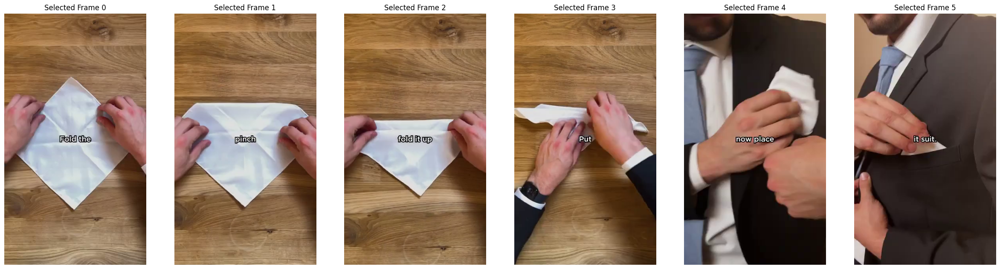

In [ ]:
# Selected frames display
fig, axs = plt.subplots(1, len(selected_frames), figsize=(30, 10))

for i, frame in enumerate(selected_frames):
    axs[i].imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    axs[i].set_title(f'Selected Frame {i}')
    axs[i].axis('off')

plt.show()

<div class="anchor" id="top" style="
    margin-right: auto;
    margin-left: auto;
    padding: 10px;
   font-size : 120%;
    background-color: #F9F1FF                                ;
    border-radius: 2px;      
    border: 2px solid #FFF6D8;">
    
The grayscale images are stored in `selected_frames` directory in png format

In [ ]:
os.listdir('selected_frames')

['frame_0098.png',
 'frame_0068.png',
 'frame_0169.png',
 'frame_0264.png',
 'frame_0113.png',
 'frame_0281.png']

<div class="anchor" id="top" style="
    margin-right: auto;
    margin-left: auto;
    padding: 10px;
   font-size : 120%;
    background-color: #F9F1FF                                ;
    border-radius: 2px;       
    border: 2px solid #FFF6D8;">
    
Converting the images into PIL format for passing to the model

In [ ]:
import PIL.Image
images = []
for i in os.listdir('selected_frames') :
    img = PIL.Image.open(f'selected_frames/{i}')
    images.append(img)

<div class="anchor" id="top" style="
    margin-right: auto;
    margin-left: auto;
    padding: 10px;
   font-size : 120%;
    background-color: #F9F1FF  ;                           ;
    border-radius: 2px;       
    border: 2px solid #FFF6D8;">
    
The image looks like this :

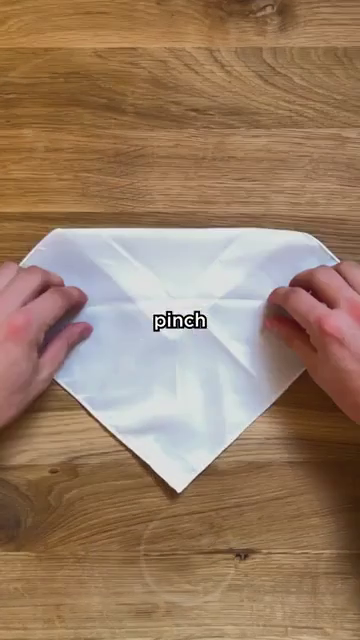

In [ ]:
images[0]

<div class="anchor" id="top" style="
    margin-right: auto;
    margin-left: auto;
    padding: 10px;
   font-size : 120%;
    background-color: #F9F1FF                                ;
    border-radius: 2px;      
    border: 2px solid #FFF6D8;">
    
Generate text from image and text prompts using `gemini-pro-vision`. Calling the model :

In [ ]:
for m in genai.list_models():
  if 'generateContent' in m.supported_generation_methods:
    print(m.name)

models/gemini-1.0-pro
models/gemini-1.0-pro-001
models/gemini-1.0-pro-latest
models/gemini-1.0-pro-vision-latest
models/gemini-1.5-flash
models/gemini-1.5-flash-001
models/gemini-1.5-flash-latest
models/gemini-1.5-pro
models/gemini-1.5-pro-001
models/gemini-1.5-pro-latest
models/gemini-pro
models/gemini-pro-vision


In [ ]:
model = genai.GenerativeModel('gemini-pro-vision')

<div class="anchor" id="top" style="
    margin-right: auto;
    margin-left: auto;
    padding: 10px;
   font-size : 120%;
    background-color: #17191e                                ;
    border-radius: 2px;
    color :  #FFFAEC  ;        
    border: 2px solid #FFF6D8;">
    
- Passing the instructions, prompts and some saved images  to the model for evaluation

In [ ]:
instructions = "Instructions: Consider the following images:"
prompt1 = "What is shown in each of the images ?"
prompt2 = """
Answer the question through these steps:
Step 1: Identify if any text is written in the images
Step 2: Identify any doodles/pictures in the images
Step 3: Grasp the collective meaning of each of the images
Step 4: What does all the images tell as a whole about the personality of the person who wrote it?
Answer and describe the steps taken:
"""
images = images[0:4]

images.insert(0, prompt2)
images.insert(0, prompt1)
images.insert(0, instructions)
display(images)

responses = model.generate_content(images)

print("-------Prompt--------")
print(images)

print("\n-------Response--------")
for response in responses:
    print(response.text, end="")


['Instructions: Consider the following images:',
 'What is shown in each of the images ?',
 '\nAnswer the question through these steps:\nStep 1: Identify if any text is written in the images\nStep 2: Identify any doodles/pictures in the images\nStep 3: Grasp the collective meaning of each of the images\nStep 4: What does all the images tell as a whole about the personality of the person who wrote it?\nAnswer and describe the steps taken:\n',
 'Instructions: Consider the following images:',
 'What is shown in each of the images ?',
 '\nAnswer the question through these steps:\nStep 1: Identify if any text is written in the images\nStep 2: Identify any doodles/pictures in the images\nStep 3: Grasp the collective meaning of each of the images\nStep 4: What does all the images tell as a whole about the personality of the person who wrote it?\nAnswer and describe the steps taken:\n',
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=360x640>]

-------Prompt--------
['Instructions: Consider the following images:', 'What is shown in each of the images ?', '\nAnswer the question through these steps:\nStep 1: Identify if any text is written in the images\nStep 2: Identify any doodles/pictures in the images\nStep 3: Grasp the collective meaning of each of the images\nStep 4: What does all the images tell as a whole about the personality of the person who wrote it?\nAnswer and describe the steps taken:\n', 'Instructions: Consider the following images:', 'What is shown in each of the images ?', '\nAnswer the question through these steps:\nStep 1: Identify if any text is written in the images\nStep 2: Identify any doodles/pictures in the images\nStep 3: Grasp the collective meaning of each of the images\nStep 4: What does all the images tell as a whole about the personality of the person who wrote it?\nAnswer and describe the steps taken:\n', <PIL.PngImagePlugin.PngImageFile image mode=RGB size=360x640 at 0x7F7407276710>]

-------Re

In [ ]:
model = genai.GenerativeModel('gemini-1.5-pro-latest')

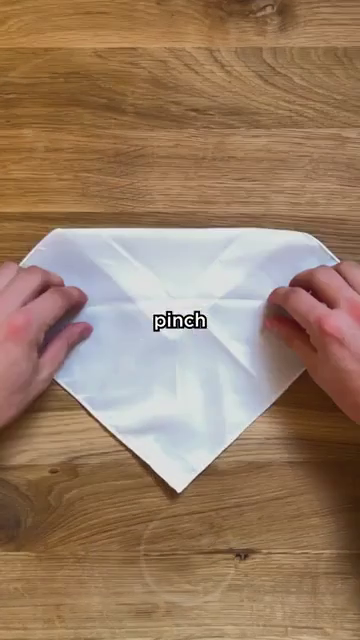

In [ ]:
images[0]

In [ ]:
instructions = "Instructions: Consider the following images:"
prompt1 = "What is shown in each of the images ?"
prompt2 = """
Answer the question through these steps:
Step 1: Identify if any text is written in the images
Step 2: Identify any doodles/pictures in the images
Step 3: Grasp the collective meaning of each of the images
Step 4: What does all the images tell as a whole about the personality of the person who wrote it?
Answer and describe the steps taken:
"""
images = images[0:4]

images.insert(0, prompt2)
images.insert(0, prompt1)
images.insert(0, instructions)
display(images)

responses = model.generate_content(images)

print("-------Prompt--------")
print(images)

print("\n-------Response--------")
for response in responses:
    print(response.text, end="")

['Instructions: Consider the following images:',
 'What is shown in each of the images ?',
 '\nAnswer the question through these steps:\nStep 1: Identify if any text is written in the images\nStep 2: Identify any doodles/pictures in the images\nStep 3: Grasp the collective meaning of each of the images\nStep 4: What does all the images tell as a whole about the personality of the person who wrote it?\nAnswer and describe the steps taken:\n',
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=360x640>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=360x640>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=360x640>,
 <PIL.PngImagePlugin.PngImageFile image mode=RGB size=360x640>]

-------Prompt--------
['Instructions: Consider the following images:', 'What is shown in each of the images ?', '\nAnswer the question through these steps:\nStep 1: Identify if any text is written in the images\nStep 2: Identify any doodles/pictures in the images\nStep 3: Grasp the collective meaning of each of the images\nStep 4: What does all the images tell as a whole about the personality of the person who wrote it?\nAnswer and describe the steps taken:\n', <PIL.PngImagePlugin.PngImageFile image mode=RGB size=360x640 at 0x7F73ABBB81C0>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=360x640 at 0x7F73ABBBAD10>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=360x640 at 0x7F7406BEE440>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=360x640 at 0x7F73C44FB100>]

-------Response--------
## Analyzing the Images:

**Step 1: Identify any text written in the images**

* Image 1: "pinch"
* Image 2: "Fold the"
* Image 3: "Put"
* Image 4: "now place"

**Step 2: Identify any d

<div class="anchor" id="top" style="
    margin-right: auto;
    margin-left: auto;
    padding: 10px;
   font-size : 120%;
    background-color: #F9F1FF                              ;
    border-radius: 2px;      
    border: 2px solid #FFF6D8;">
    
References :
    
- [Gemini API Starter Notebook](https://www.kaggle.com/code/prathameshbang/gemini-api-starter-notebook/notebook)
- [Working with video in Python by Rob Mulla](https://www.kaggle.com/code/robikscube/working-with-video-in-python-youtube-tutorial/notebook)